<a href="https://colab.research.google.com/github/zganjei/Credit-Card-Fraud-Detection/blob/main/fraud_detection_genAI_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fraud detection with GAN

This is a tool prototype to help a financial institution to improve the accuracy of their fraud detection leveraging Generative AI.
The challenge is that the data is imbalanced, since fraudulent transactions are much less than the eligible ones. To solve this problem as a data scientist I am going to use GAN (Generative Adversarial Networks) to generate synthetic fraudulent transactions that are indistinguishable from real fraudulent transactions. This data will balance the dataset and boost the accuracy of the fraud detection model.

## Importing the required modules
Here i'm going to use Numpy, Pandas, Tensorflow, Sklearn, Seaborn, and  Matplotlib.

In [2]:
import numpy as np
import pandas as pd

# Importing required modules for neural network
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, BatchNormalization, LeakyReLU, Dropout
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import RandomNormal

# Importing ML modules
from sklearn.utils import shuffle
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Importing data visualization modules
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

print("Finished importing modules!")

Finished importing modules!


## Importing the dataset

In [3]:
from google.colab import drive
drive.mount('/content/drive')
data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Creditcard_dataset.csv')
data.head()

Mounted at /content/drive


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,1,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
1,7,-0.644269,1.417964,1.074380,-0.492199,0.948934,0.428118,1.120631,-3.807864,0.615375,...,1.943465,-1.015455,0.057504,-0.649709,-0.415267,-0.051634,-1.206921,-1.085339,40.80,0
2,10,1.449044,-1.176339,0.913860,-1.375667,-1.971383,-0.629152,-1.423236,0.048456,-1.720408,...,-0.009302,0.313894,0.027740,0.500512,0.251367,-0.129478,0.042850,0.016253,7.80,0
3,10,0.384978,0.616109,-0.874300,-0.094019,2.924584,3.317027,0.470455,0.538247,-0.558895,...,0.049924,0.238422,0.009130,0.996710,-0.767315,-0.492208,0.042472,-0.054337,9.99,0
4,11,1.069374,0.287722,0.828613,2.712520,-0.178398,0.337544,-0.096717,0.115982,-0.221083,...,-0.036876,0.074412,-0.071407,0.104744,0.548265,0.104094,0.021491,0.021293,27.50,0


Let's now check the shape of the data

In [4]:
data.shape

(50492, 31)

Now it's time to see how many genuine vs fraudulent records we have

In [5]:
data.Class.value_counts()

,count
Class,
0,50000
1,492


It seems that the dataset is so imbalanced!

## Data Preprocessing and Exploration
In this step i'm gonna do the following:
* Remove the rows with ```Nan``` values
* Remove ```Time``` column
* Feature scale the ```Amount``` column
* Split the data into features and labels
* Explore the data

Remove the rows with Nan values from the dataset

In [6]:
data.dropna(inplace=True)
data.shape

(50492, 31)

It seems that we didn't have any ```Nan``` values!

Remove the time column as it is not in our analysis

In [7]:
data = data.drop(axis=1, columns='Time')
data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
1,-0.644269,1.417964,1.074380,-0.492199,0.948934,0.428118,1.120631,-3.807864,0.615375,1.249376,...,1.943465,-1.015455,0.057504,-0.649709,-0.415267,-0.051634,-1.206921,-1.085339,40.80,0
2,1.449044,-1.176339,0.913860,-1.375667,-1.971383,-0.629152,-1.423236,0.048456,-1.720408,1.626659,...,-0.009302,0.313894,0.027740,0.500512,0.251367,-0.129478,0.042850,0.016253,7.80,0
3,0.384978,0.616109,-0.874300,-0.094019,2.924584,3.317027,0.470455,0.538247,-0.558895,0.309755,...,0.049924,0.238422,0.009130,0.996710,-0.767315,-0.492208,0.042472,-0.054337,9.99,0
4,1.069374,0.287722,0.828613,2.712520,-0.178398,0.337544,-0.096717,0.115982,-0.221083,0.460230,...,-0.036876,0.074412,-0.071407,0.104744,0.548265,0.104094,0.021491,0.021293,27.50,0


Feature scaling the ```Amount``` column
V1 to V28 columns are already scaled. I should now scale the ```Amount``` column to not bias the ML model and to make features comparable.

In [8]:
scaler = StandardScaler()
data['Amount'] = scaler.fit_transform(data[['Amount']])
data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,0.150105,0
1,-0.644269,1.417964,1.074380,-0.492199,0.948934,0.428118,1.120631,-3.807864,0.615375,1.249376,...,1.943465,-1.015455,0.057504,-0.649709,-0.415267,-0.051634,-1.206921,-1.085339,-0.199848,0
2,1.449044,-1.176339,0.913860,-1.375667,-1.971383,-0.629152,-1.423236,0.048456,-1.720408,1.626659,...,-0.009302,0.313894,0.027740,0.500512,0.251367,-0.129478,0.042850,0.016253,-0.339490,0
3,0.384978,0.616109,-0.874300,-0.094019,2.924584,3.317027,0.470455,0.538247,-0.558895,0.309755,...,0.049924,0.238422,0.009130,0.996710,-0.767315,-0.492208,0.042472,-0.054337,-0.330223,0
4,1.069374,0.287722,0.828613,2.712520,-0.178398,0.337544,-0.096717,0.115982,-0.221083,0.460230,...,-0.036876,0.074412,-0.071407,0.104744,0.548265,0.104094,0.021491,0.021293,-0.256128,0


Now I'm gonna separate genuine and fraud records into two separate dataframes

In [9]:
data_fraud = data[data.Class ==1]
data_genuine = data[data.Class == 0]
data_fraud

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
50000,-2.312227,1.951992,-1.609851,3.997906,-0.522188,-1.426545,-2.537387,1.391657,-2.770089,-2.772272,...,0.517232,-0.035049,-0.465211,0.320198,0.044519,0.177840,0.261145,-0.143276,-0.372497,1
50001,-3.043541,-3.157307,1.088463,2.288644,1.359805,-1.064823,0.325574,-0.067794,-0.270953,-0.838587,...,0.661696,0.435477,1.375966,-0.293803,0.279798,-0.145362,-0.252773,0.035764,1.866017,1
50002,-2.303350,1.759247,-0.359745,2.330243,-0.821628,-0.075788,0.562320,-0.399147,-0.238253,-1.525412,...,-0.294166,-0.932391,0.172726,-0.087330,-0.156114,-0.542628,0.039566,-0.153029,0.642790,1
50003,-4.397974,1.358367,-2.592844,2.679787,-1.128131,-1.706536,-3.496197,-0.248778,-0.247768,-4.801637,...,0.573574,0.176968,-0.436207,-0.053502,0.252405,-0.657488,-0.827136,0.849573,-0.122833,1
50004,1.234235,3.019740,-4.304597,4.732795,3.624201,-1.357746,1.713445,-0.496358,-1.282858,-2.447469,...,-0.379068,-0.704181,-0.656805,-1.632653,1.488901,0.566797,-0.010016,0.146793,-0.368265,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50487,-1.927883,1.125653,-4.518331,1.749293,-1.566487,-2.010494,-0.882850,0.697211,-2.064945,-5.587794,...,0.778584,-0.319189,0.639419,-0.294885,0.537503,0.788395,0.292680,0.147968,1.277825,1
50488,1.378559,1.289381,-5.004247,1.411850,0.442581,-1.326536,-1.413170,0.248525,-1.127396,-3.232153,...,0.370612,0.028234,-0.145640,-0.081049,0.521875,0.739467,0.389152,0.186637,-0.369281,1
50489,-0.676143,1.126366,-2.213700,0.468308,-1.120541,-0.003346,-2.234739,1.210158,-0.652250,-3.463891,...,0.751826,0.834108,0.190944,0.032070,-0.739695,0.471111,0.385107,0.194361,-0.042898,1
50490,-3.113832,0.585864,-5.399730,1.817092,-0.840618,-2.943548,-2.208002,1.058733,-1.632333,-5.245984,...,0.583276,-0.269209,-0.456108,-0.183659,-0.328168,0.606116,0.884876,-0.253700,0.664244,1


Split the data into features and labels

In [10]:
X = data.drop("Class",axis=1)
y = data["Class"]
X.shape

(50492, 29)

Explore the dataset
* Use PCA to reduce the dimensionality of features ```X``` into two dimensions. Add the labels to it.
* Visualize the data with scatter plot

In [11]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)
df = pd.DataFrame(data=X_pca, columns=['PC1', 'PC2'])
df['label'] = y
df.head()

,PC1,PC2,label
0,0.447840,-1.197485,0
1,0.582393,-0.258062,0
2,0.939390,0.728299,0
3,0.630766,0.499103,0
4,0.536287,1.055403,0


In [12]:
px.scatter(df, x = "PC1", y = "PC2", color = df.label.astype(str))

## Implement GAN to syntesize fraudulen data
In the following I'm going to use Generative Adversarial Networks to generate some synthetic data to solve the issue of imbalanced data.

## Building the Generator Model
I define a function to create the generator model. It gets a random noise vector with 29 features and it generates also 29 features.
```he_uniform``` is an initialization that helps training of neural networks.
I also use Batch normalization to normalize the activations of a layer in the neural network. It stabilizes and accelerates the learning of the NN.

In [13]:
def build_generator():
  model = Sequential()
  #input layer
  model.add(Input(shape=(29, )))
  model.add(BatchNormalization())
  #hidden layers
  model.add(Dense(64, activation = 'relu'))
  model.add(BatchNormalization())

  model.add(Dense(128, activation = 'relu'))
  model.add(BatchNormalization())

  #output layer
  model.add(Dense(29, activation = 'linear'))
  model.summary()
  return model

build_generator()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ batch_normalization                  │ (None, 29)                  │             116 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 64)                  │           1,920 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 64)                  │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 128)                 │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 128)                 │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 29)                  │           3,741 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,865 (58.07 KB)

 Trainable params: 14,423 (56.34 KB)

 Non-trainable params: 442 (1.73 KB)

<Sequential name=sequential, built=True>

## Building the discriminator model

I add the following function to create the architure of discriminator model. Discriminator is a binary classifier that tries to distinguish between real and fake fraudulent transactions. In the output of the model we need only one neuron because it will act as a classifier.

In [14]:
def build_discriminator():
  model = Sequential()
  #input layer
  model.add(Input(shape=(29,)))
  #hidden layers
  model.add(Dense(64,activation='relu'))
  model.add(Dense(32,activation='relu'))
  model.add(Dense(32,activation='relu'))
  model.add(Dense(16,activation='relu'))
  #output layer
  model.add(Dense(1,activation='sigmoid'))
  model.compile(optimizer='adam', loss='binary_crossentropy')
  model.summary()
  return model

build_discriminator()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_3 (Dense)                      │ (None, 64)                  │           1,920 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 32)                  │           1,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 16)                  │             528 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,601 (21.88 KB)

 Trainable params: 5,601 (21.88 KB)

 Non-trainable params: 0 (0.00 B)

<Sequential name=sequential_1, built=True>

#Combine discriminator and generator models to build a GAN
The output of the generator, is the input to discriminator. I'll train the GAN iteratively. In the first step, I train the generator and freez the discriminator because otherwise discriminator will be very good at distinguishing real from fake data. This will catch generator's mistakes very fast and hence, will not allow it to make any progress.

In the next step, we unfreez the discriminator.

In [15]:
def build_gan(generator,discriminator):
  # freez the discriminator
  discriminator.trainable = False
  gan_input = Input(shape=generator.input_shape[1:])
  synthetic_data = generator(gan_input)
  gan_output = discriminator(synthetic_data)
  gan = Model(gan_input,gan_output)
  gan.summary()
  return gan

I add a function here that uses the generator to generate synthetic data. The input to the generator is noise. I'll put gausian distribution, with mean=0 and standard deviation =1.

In [16]:
def generate_synthetic_data(generator, num_samples):
  noise = np.random.normal(0,1,size=(num_samples,29))
  synthetic_data = generator.predict(noise,verbose=0)
  return synthetic_data


## Train and Evaluate the GAN

I'll start off by adding a function to monoitor the generator being trained

In [17]:
def monitor_generator(generator):
  pca = PCA(n_components=2)

  # drop the column 'Class' from the fraud dataset
  real_fraud_data = data_fraud.drop('Class', axis=1)

  # use PCA to shrink dimension of real_fraud_data
  transformed_real_data = pca.fit_transform(real_fraud_data)

  #store the transformed data in a dataframe and mark it as 'real'
  df_real = pd.DataFrame(data=transformed_real_data, columns=['PC1', 'PC2'])
  df_real['label'] = 'real'

  # generate synthetic fraud data using the generator
  synthetic_data = generate_synthetic_data(generator, 492)

  #transform the synthetic data similarly with PCA
  transformed_synthetic_data = pca.transform(synthetic_data)

  #store the transformed data in a dataframe and mark it as 'synthetic'
  df_synthetic = pd.DataFrame(data=transformed_synthetic_data, columns=['PC1', 'PC2'])
  df_synthetic['label'] = 'synthetic'

  #concatenate the real and synthetic data
  df_combined = pd.concat([df_real,df_synthetic])

  #use scatterplot to visualize the data points using pca as well as the label column
  plt.figure()
  sns.scatterplot(data=df_combined,x='PC1',y='PC2',hue='label',s=10)
  plt.show()


## Training the GAN
In each epoch we'll use the generator to generate half-a-batch data points. The other half-a-batch will be real data from the dataset. Then we use this to train the discriminator to distinguish between real and synthetic data. To train the generator, I need to use the whole structure of the GAN. Discriminator will give the generator feedback about how good it is generating.

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ batch_normalization_3                │ (None, 29)                  │             116 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 64)                  │           1,920 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 64)                  │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 128)                 │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 128)                 │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 29)                  │           3,741 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,865 (58.07 KB)

 Trainable params: 14,423 (56.34 KB)

 Non-trainable params: 442 (1.73 KB)

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_11 (Dense)                     │ (None, 64)                  │           1,920 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_12 (Dense)                     │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_13 (Dense)                     │ (None, 32)                  │           1,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 16)                  │             528 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_15 (Dense)                     │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 5,601 (21.88 KB)

 Trainable params: 5,601 (21.88 KB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 29)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential_2 (Sequential)            │ (None, 29)                  │          14,865 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential_3 (Sequential)            │ (None, 1)                   │           5,601 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 20,466 (79.95 KB)

 Trainable params: 14,423 (56.34 KB)

 Non-trainable params: 6,043 (23.61 KB)

Epoch:  0


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but PCA was fitted with feature names



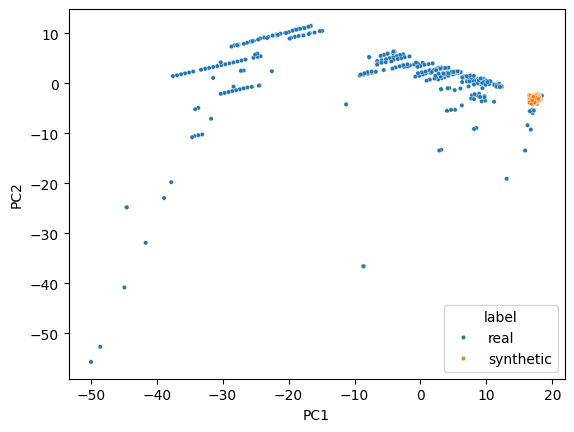

Epoch:  200


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but PCA was fitted with feature names



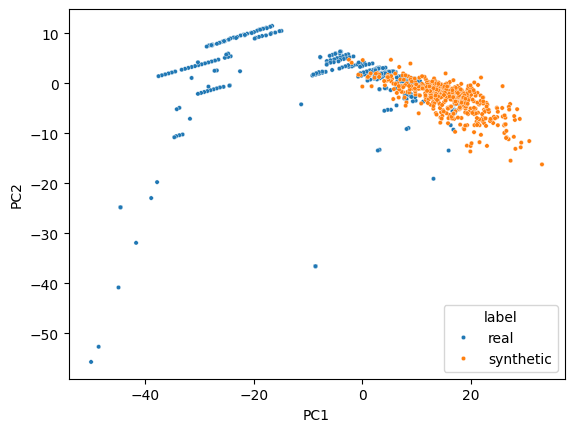

Epoch:  400


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but PCA was fitted with feature names



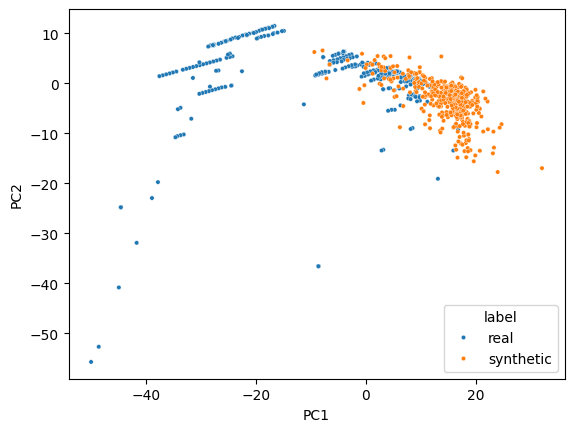

Epoch:  600


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but PCA was fitted with feature names



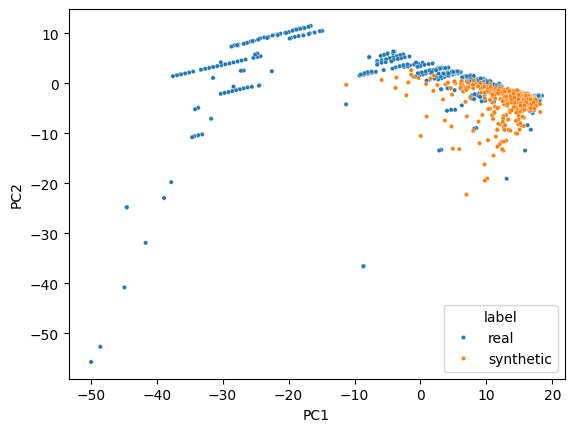

Epoch:  800


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but PCA was fitted with feature names



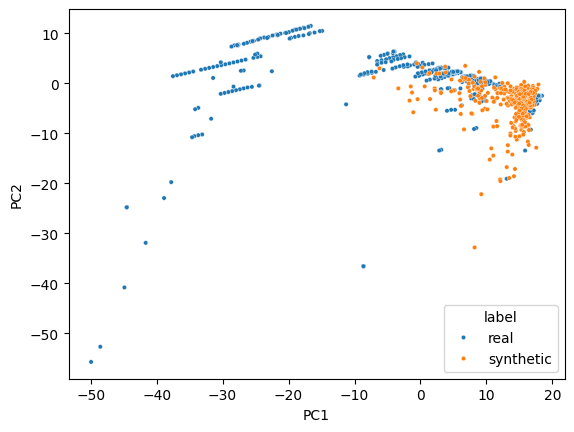

In [18]:
generator = build_generator()
discriminator = build_discriminator()
gan = build_gan(generator,discriminator)
gan.compile(optimizer='adam', loss='binary_crossentropy')
# set hyper-parameters
epochs = 1000
batch_size =64
half_batch =(batch_size//2)
y_synthetic = np.zeros((half_batch,1))
X_real = data_fraud.sample(half_batch).drop('Class', axis=1)
y_real = np.ones((half_batch,1))

#training loop
for epoch in range(epochs):
  #generate synthetic data
  X_synthetic = generate_synthetic_data(generator, half_batch)


  #unfreez the discriminator
  discriminator.trainable = True
  #train the discriminator
  discriminator.train_on_batch(X_real, y_real)
  discriminator.train_on_batch(X_synthetic, y_synthetic)

  noise = np.random.normal(0,1,(batch_size,29))
  # we ful the discriminator by marking the noise data as real data
  gan.train_on_batch(noise, np.ones((batch_size,1)))

  if epoch % 200 == 0:
    print("Epoch: ", epoch)
    #monitor the generator
    monitor_generator(generator)


## Generate Synthetic data by the generator

Now let's generate 1000 synthetic records using the generator that we just trained! We'll then evaluate the quality of the generated data by comparing their distribution with that of the real data.

In [20]:
synthetic_data = generate_synthetic_data(generator, 1000)

df = pd.DataFrame(data=synthetic_data)
df['label'] = 'fake'
df2 = data_fraud.drop('Class',axis=1)
df2['label'] = 'real'
df2.columns = df.columns
combined_df = pd.concat([df,df2])
combined_df

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,label
0,-2.060526,0.908997,-2.302061,0.707248,0.760906,-0.722278,0.019222,-1.263486,-1.202165,-1.275007,...,-0.271016,1.127744,-1.043171,0.040049,-0.364552,-0.748405,-1.109375,-0.175836,1.870166,fake
1,-0.888388,0.705366,-2.685670,0.361062,0.433060,-0.602293,0.330710,-1.200483,-0.906385,-1.386690,...,-0.635727,1.227595,-1.214759,-0.022141,-0.427214,-1.222485,-0.987338,-0.080909,2.721133,fake
2,-0.928123,1.944242,-3.810257,-0.558721,0.770672,-0.168908,0.386090,-1.819612,-0.739991,-0.608553,...,-0.210669,1.452444,-1.404425,0.309839,-0.187161,-1.521693,-1.411279,0.057069,3.226249,fake
3,-1.862686,0.542934,-1.881598,1.571445,0.696052,-0.642081,0.391872,-0.943499,-1.022102,-1.958730,...,-0.343342,1.330316,-1.198947,-0.570480,0.587735,-0.724218,-0.050963,-0.545689,1.862973,fake
4,-1.178948,-0.337658,-2.693090,1.046209,-0.288365,-0.422396,-0.613742,0.300465,-0.202716,-2.402598,...,0.229481,0.324065,-1.397536,-0.476490,0.492750,-0.884974,-0.489772,-1.076448,2.007253,fake
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50487,-1.927883,1.125653,-4.518331,1.749293,-1.566487,-2.010494,-0.882850,0.697211,-2.064945,-5.587794,...,0.778584,-0.319189,0.639419,-0.294885,0.537503,0.788395,0.292680,0.147968,1.277825,real
50488,1.378559,1.289381,-5.004247,1.411850,0.442581,-1.326536,-1.413170,0.248525,-1.127396,-3.232153,...,0.370612,0.028234,-0.145640,-0.081049,0.521875,0.739467,0.389152,0.186637,-0.369281,real
50489,-0.676143,1.126366,-2.213700,0.468308,-1.120541,-0.003346,-2.234739,1.210158,-0.652250,-3.463891,...,0.751826,0.834108,0.190944,0.032070,-0.739695,0.471111,0.385107,0.194361,-0.042898,real
50490,-3.113832,0.585864,-5.399730,1.817092,-0.840618,-2.943548,-2.208002,1.058733,-1.632333,-5.245984,...,0.583276,-0.269209,-0.456108,-0.183659,-0.328168,0.606116,0.884876,-0.253700,0.664244,real


Now let's check the distribution of individual features of ```synthetic``` and ```real``` fraud data.

In [21]:
for col in combined_df.columns:
  plt.figure()
  fig = px.histogram(combined_df, x=col, color='label', barmode="overlay", marginal='box', hover_data=combined_df.columns)
  fig.show()

<ipython-input-21-55ae5a84a629>:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>